In [1]:
import torch
from torch import nn
from jaxtyping import Array, Float, Integer, Complex
from typing import Callable
import numpy as np

In [2]:
type HilbertVector = Complex[torch.Tensor, "num_walkers"] | Float[
    torch.Tensor, "num_walkers"
]
type Psi = Callable[
    [Float[torch.Tensor, "3 num_walkers"]],
    Complex[torch.Tensor, "num_walkers"] | Float[torch.Tensor, "num_walkers"],
]
type Position = Float[torch.Tensor, "3 #num_walkers"]

In [3]:
class MarkovChain:
    def __init__(
        self,
        psi: Psi,
        r_min: Position,
        r_max: Position,
        n_walkers: int,
    ):
        self.psi: Psi = psi
        self.state: Position = torch.rand(3, n_walkers)
        self.n_walkers: int = n_walkers
        self.r_min: Position = r_min.reshape(3, 1)
        self.r_max: Position = r_max.reshape(3, 1)

    def make_step(self, step_size: float):
        step: Position = torch.randn(3, self.n_walkers)
        step = step * (self.r_max - self.r_min) * step_size
        return step

    def metropolis(self, step_size: float):
        proposed_step: Position = self.make_step(step_size)
        proposed_state: Position = self.state + proposed_step

        prob_dist = self.psi(self.state)
        prob_dist = torch.real(prob_dist.conj() * prob_dist)

        proposed_prob_dist = self.psi(proposed_state)
        proposed_prob_dist = torch.real(proposed_prob_dist.conj() * proposed_prob_dist)

        acceptance_mask = torch.rand(self.n_walkers) < (proposed_prob_dist / prob_dist)

        self.state = torch.where(acceptance_mask, proposed_state, self.state)

        return self.state

In [4]:
def test_psi(x: Position) -> HilbertVector:
    return torch.exp(-torch.sum(x**2, axis=0))


psi: Psi = test_psi

In [5]:
x, y, z = torch.meshgrid(
    torch.linspace(-1.2, 1.2, 10),
    torch.linspace(-1.2, 1.2, 10),
    torch.linspace(-1.2, 1.2, 10),
)

sample_points = torch.stack([x, y, z], axis=0).reshape(3, -1)

psi(sample_points)
prob_dist = torch.real(psi(sample_points).conj() * psi(sample_points))

/home/spandan/anaconda3/envs/tqs2/lib/python3.12/site-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /home/conda/feedstock_root/build_artifacts/libtorch_1718580740865/work/aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [6]:
sample_points

tensor([[-1.2000, -1.2000, -1.2000,  ...,  1.2000,  1.2000,  1.2000],
        [-1.2000, -1.2000, -1.2000,  ...,  1.2000,  1.2000,  1.2000],
        [-1.2000, -0.9333, -0.6667,  ...,  0.6667,  0.9333,  1.2000]])

In [7]:
prob_dist

tensor([1.7689e-04, 5.5186e-04, 1.2955e-03, 2.2882e-03, 3.0410e-03, 3.0410e-03,
        2.2882e-03, 1.2955e-03, 5.5186e-04, 1.7689e-04, 5.5186e-04, 1.7217e-03,
        4.0416e-03, 7.1387e-03, 9.4875e-03, 9.4875e-03, 7.1387e-03, 4.0416e-03,
        1.7217e-03, 5.5186e-04, 1.2955e-03, 4.0416e-03, 9.4875e-03, 1.6758e-02,
        2.2272e-02, 2.2272e-02, 1.6758e-02, 9.4875e-03, 4.0416e-03, 1.2955e-03,
        2.2882e-03, 7.1387e-03, 1.6758e-02, 2.9599e-02, 3.9338e-02, 3.9338e-02,
        2.9599e-02, 1.6758e-02, 7.1387e-03, 2.2882e-03, 3.0410e-03, 9.4875e-03,
        2.2272e-02, 3.9338e-02, 5.2282e-02, 5.2282e-02, 3.9338e-02, 2.2272e-02,
        9.4875e-03, 3.0410e-03, 3.0410e-03, 9.4875e-03, 2.2272e-02, 3.9338e-02,
        5.2282e-02, 5.2282e-02, 3.9338e-02, 2.2272e-02, 9.4875e-03, 3.0410e-03,
        2.2882e-03, 7.1387e-03, 1.6758e-02, 2.9599e-02, 3.9338e-02, 3.9338e-02,
        2.9599e-02, 1.6758e-02, 7.1387e-03, 2.2882e-03, 1.2955e-03, 4.0416e-03,
        9.4875e-03, 1.6758e-02, 2.2272e-

In [8]:
import plotly.graph_objects as go

isofig = go.Figure(
    data=[
        go.Volume(
            x=sample_points[0].flatten(),
            y=sample_points[1].flatten(),
            z=sample_points[2].flatten(),
            value=prob_dist.flatten(),
            isomin=0,  # prob_dist.min().item(),,
            isomax=1,  # prob_dist.max().item(),
            opacity=0.05,
            surface_count=10,
            colorscale="Plasma",
        )
    ]
)

isofig.update_layout(scene=dict(xaxis_title="X", yaxis_title="Y", zaxis_title="Z"))

isofig.show()

In [9]:
import plotly.graph_objects as go
import numpy as np

num_walkers = 10000
num_updates = 100
warmup_steps = 100000
step_size = 0.2
warmup_step_size = 0.2

r_min = torch.tensor([-1.0, -1.0, -1.0])
r_max = torch.tensor([1.0, 1.0, 1.0])
mc = MarkovChain(psi, r_min, r_max, num_walkers)

warmup_coords: Float[torch.Tensor, "3 num_walkers warmup_steps"] = torch.zeros(
    3, num_walkers, warmup_steps
)

coords: Float[torch.Tensor, "3 num_walkers timesteps"] = torch.zeros(
    3, num_walkers, num_updates
)

for i in range(warmup_steps):
    warmup_coords[:, :, i] = mc.metropolis(0.01)
    # mc.metropolis(warmup_step_size)

# Run the Metropolis algorithm for 10 iterations
for i in range(num_updates):
    coords[:, :, i] = mc.metropolis(step_size)


fig = isofig

# Plot each iteration's coordinates with a different color
for i in range(num_updates):
    fig.add_trace(
        go.Scatter3d(
            x=coords[0, :, i].tolist(),
            y=coords[1, :, i].tolist(),
            z=coords[2, :, i].tolist(),
            mode="markers",
            marker=dict(
                size=1,
                color=[i] * num_walkers,  # Color points by iteration number
                colorscale="Plasma",
                colorbar=dict(title="Iteration"),
                cmin=0,
                cmax=num_updates,
            ),
            opacity=1,
        )
    )

# Set labels for the axes
fig.update_layout(scene=dict(xaxis_title="X", yaxis_title="Y", zaxis_title="Z"))

# Show the plot
fig.show()

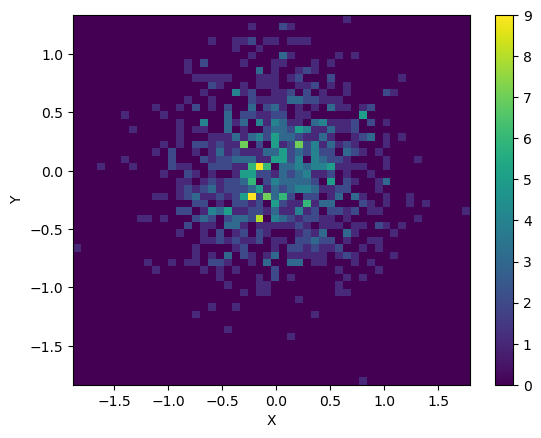

In [10]:
import matplotlib.pyplot as plt

# Extract the x and y coordinates from the coords tensor
x_coords = coords[0, :, -1].flatten().tolist()
y_coords = coords[1, :, -1].flatten().tolist()

# Create a 2D histogram
plt.hist2d(x_coords, y_coords, bins=50, cmap="viridis")

# Set labels for the axes
plt.xlabel("X")
plt.ylabel("Y")

# Add a colorbar
plt.colorbar()

# Show the plot
plt.show()

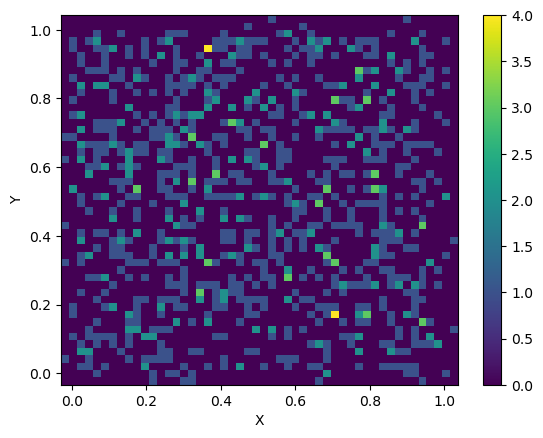

In [12]:
import matplotlib.pyplot as plt

# Extract the x and y coordinates from the coords tensor
x_coords = warmup_coords[0, :, 0].flatten().tolist()
y_coords = warmup_coords[1, :, 0].flatten().tolist()

# Create a 2D histogram
plt.hist2d(x_coords, y_coords, bins=50, cmap="viridis")

# Set labels for the axes
plt.xlabel("X")
plt.ylabel("Y")

# Add a colorbar
plt.colorbar()

# Show the plot
plt.show()